In [2]:

import numpy as np
import pandas as pd
import Perceptron as p
import P_helpers as ph
from P_helpers import eval_guesses_to_csv


# ph.eval_guesses_to_csv(1, 1, None, "glove.eval.guesses.csv")



In [3]:

BOW_train = pd.read_csv('../project_data/data/bag-of-words/bow.train.csv').replace({'label': {0: -1}})
BOW_test = pd.read_csv('../project_data/data/bag-of-words/bow.test.csv').replace({'label': {0: -1}})
BOW_eval = pd.read_csv('../project_data/data/bag-of-words/bow.eval.anon.csv').replace({'label': {0: -1}})

glove_train = pd.read_csv('../project_data/data/glove/glove.train.csv').replace({'label': {0: -1}})
glove_test = pd.read_csv('../project_data/data/glove/glove.test.csv').replace({'label': {0: -1}})
glove_eval = pd.read_csv('../project_data/data/glove/glove.eval.anon.csv').replace({'label': {0: -1}})

tfidf_train = pd.read_csv('../project_data/data/tfidf/tfidf.train.csv').replace({'label': {0: -1}})    
tfidf_test = pd.read_csv('../project_data/data/tfidf/tfidf.test.csv').replace({'label': {0: -1}})
tfidf_eval = pd.read_csv('../project_data/data/tfidf/tfidf.eval.anon.csv').replace({'label': {0: -1}})




In [7]:
BOW_train_smol = BOW_train.iloc[:100]
BOW_train_smol_folds = np.array_split(BOW_train_smol, 5)

BOW_train_folds = np.array_split(BOW_train, 5)

In [ ]:
####### DETERMINE BEST LEARNING RATE FOR AVG PERCEPTRON #######

print('\n## Averaged Perceptron ##')
try: 
    train_folds = BOW_train_folds
    T = 10
    n_vals = [1, 0.1, 0.01]
    highest_accuracy = 0
    best_n = -1
    best_sums = (0, 0)
    for n in n_vals:
        model = p.AveragedPerceptron(train_folds, T, n)
        accuracy = model.cross_validation()
        if accuracy > highest_accuracy:
            highest_accuracy = accuracy
            best_n = n
            best_sums = (model.best_a, model.best_ba)
    print("Best n: ", best_n, "\nAccuracy: ", highest_accuracy)
    print("Best sums- \n: ", best_sums[0], '\nba: ', best_sums[1])
    
except Exception as e:
    print(e)
    print("Error in Averaged Perceptron")



### running it with first 1000 rows said 1 was the best learning rate
### 4/4/2024 - after fixing, .01 is the best learning rate

In [13]:
### train the model with the best learning ###
train_folds = BOW_train_folds
T = 20
model = p.AveragedPerceptron(train_folds, T, .01)
best_accuracy = -1
best_a = None
best_ba = None
acc_dict = {}
for t in range(T):
    BOW_train = BOW_train.sample(frac=1, random_state=42)
    model.run_epoch(BOW_train)
    accuracy = model.test_accuracy(BOW_test)
    acc_dict[t] = accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_a = model.a
        best_ba = model.ba



## Averaged Perceptron ##
Total number of updates performed on training set:  84509
Best accuracy on test set after 20 epochs:  0.7
Accuracy on test set:  0.7


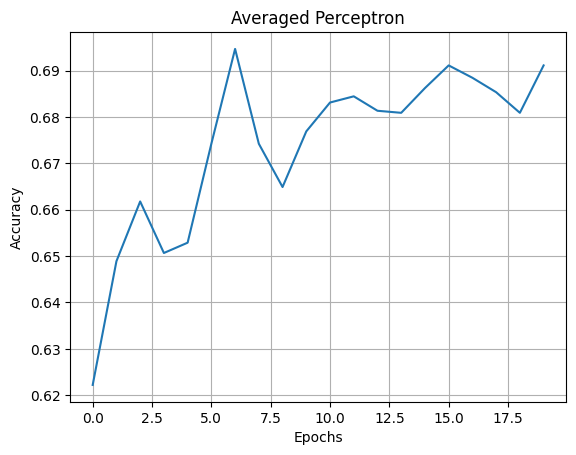

In [14]:
####### Test Average Perceptron #######

sum_classifiers = (model.a, model.ba)
best_accuracy = ph.test_accuracy_classifiers(BOW_test, sum_classifiers[0], sum_classifiers[1])
        
print("\n## Averaged Perceptron ##")
print("Total number of updates performed on training set: ", model.num_updates)
print("Best accuracy on test set after 20 epochs: ", best_accuracy)
# print("Best accuracy on dev set within 20 epochs: ", best_accuracy)
w = sum_classifiers[0]
b = sum_classifiers[1]
print("Accuracy on test set: ", best_accuracy)
ph.plot_learning_curve(acc_dict, 'Averaged Perceptron')


In [60]:
# a = model.a
# ba = model.ba
# np.savetxt('a.csv', a, delimiter=',')
# np.savetxt('ba.csv', ba, delimiter=',')


In [ ]:
### test on eval set ###

# BOW_eval_labels = BOW_eval['label']
# BOW_eval_features = BOW_eval.drop(columns=['label'])
# BOW_eval_df = pd.concat([BOW_eval_labels, BOW_eval_features], axis=1)
### we can't test accuracy on the eval data, as we don't have the labels for it. ###
# a = pd.read_csv('a.csv', header=None).to_numpy().flatten()
# ba = pd.read_csv('ba.csv', header=None).to_numpy()[0][0]

a = best_a
ba = best_ba

ph.eval_guesses_to_csv(a, ba, BOW_eval.drop(columns=['label']), "glove.eval.guesses.csv")


------- Now doing for tfidf ----------- 

In [19]:
tfidf_train_folds = np.array_split(tfidf_train, 5)

In [20]:
####### DETERMINE BEST LEARNING RATE FOR AVG PERCEPTRON #######

print('\n## Averaged Perceptron ##')
try: 
    train_folds = tfidf_train_folds
    T = 10
    n_vals = [1, 0.1, 0.01]
    highest_accuracy = 0
    best_n = -1
    best_sums = (0, 0)
    for n in n_vals:
        model = p.AveragedPerceptron(train_folds, T, n)
        accuracy = model.cross_validation()
        if accuracy > highest_accuracy:
            highest_accuracy = accuracy
            best_n = n
            best_sums = (model.best_a, model.best_ba)
    print("Best n: ", best_n, "\nAccuracy: ", highest_accuracy)
    print("Best sums- \n: ", best_sums[0], '\nba: ', best_sums[1])
    
except Exception as e:
    print("Error in Averaged Perceptron")



## Averaged Perceptron ##
Best n:  1 
Accuracy:  0.7586857142857143
Best sums- 
:  x0       245002.240655
x1        76026.907149
x2      -322931.983393
x3       181044.576614
x4       -64344.513598
             ...      
x9995     52022.228046
x9996   -541185.850935
x9997    112260.637897
x9998     76891.318704
x9999    -12341.522607
Name: 2900, Length: 10000, dtype: float64 
ba:  [134789.49011593]


In [21]:
### train the model with the best learning ###
train_folds = tfidf_train_folds
T = 20
model = p.AveragedPerceptron(train_folds, T, .01)
best_accuracy = -1
best_a = None
best_ba = None
acc_dict = {}
for t in range(T):
    tfidf_train = tfidf_train.sample(frac=1, random_state=42)
    model.run_epoch(tfidf_train)
    accuracy = model.test_accuracy(tfidf_test)
    acc_dict[t] = accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_a = model.a
        best_ba = model.ba



## Averaged Perceptron ##
Total number of updates performed on training set:  58914
Best accuracy on test set after 20 epochs:  0.6915555555555556
Accuracy on test set:  0.6915555555555556


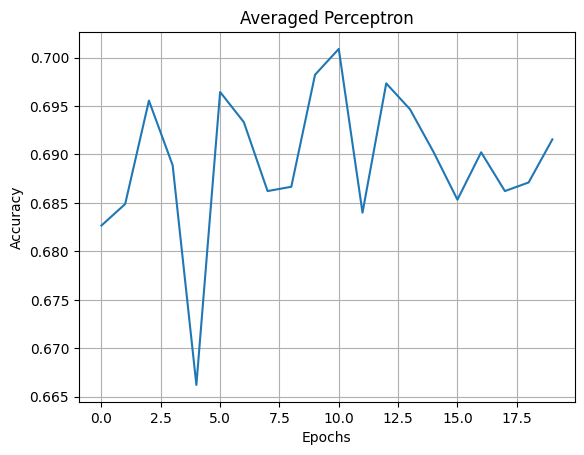

In [22]:
####### Test Average Perceptron #######

sum_classifiers = (model.a, model.ba)
best_accuracy = ph.test_accuracy_classifiers(tfidf_test, sum_classifiers[0], sum_classifiers[1])
        
print("\n## Averaged Perceptron ##")
print("Total number of updates performed on training set: ", model.num_updates)
print("Best accuracy on test set after 20 epochs: ", best_accuracy)
# print("Best accuracy on dev set within 20 epochs: ", best_accuracy)
w = sum_classifiers[0]
b = sum_classifiers[1]
print("Accuracy on test set: ", best_accuracy)
ph.plot_learning_curve(acc_dict, 'Averaged Perceptron')


In [23]:
a = best_a
ba = best_ba

ph.eval_guesses_to_csv(a, ba, tfidf_eval.drop(columns=['label']), "tfidf.eval.guesses.csv")

[0. 0. 0. ... 0. 0. 0.]
[0.         0.02596591 0.         ... 0.         0.         0.        ]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.         0.         ... 0.         0.         0.03531224]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.08886737 0.         ... 0.         0.         0.        ]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.23495105 0.         ... 0.         0.         0.        ]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.10494205 0.         ... 0.         0.         0.        ]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.         0.01780887 ... 0.         0.         0.        ]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0.        0.0941885 0.        ... 0.        0.        0.       ]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.03536065

-------- now for glove ------------

In [4]:
glove_train_folds = np.array_split(glove_train, 5)

In [5]:
####### DETERMINE BEST LEARNING RATE FOR AVG PERCEPTRON #######

print('\n## Averaged Perceptron ##')
try: 
    train_folds = glove_train_folds
    T = 10
    n_vals = [1, 0.1, 0.01]
    highest_accuracy = 0
    best_n = -1
    best_sums = (0, 0)
    for n in n_vals:
        model = p.AveragedPerceptron(train_folds, T, n)
        accuracy = model.cross_validation()
        if accuracy > highest_accuracy:
            highest_accuracy = accuracy
            best_n = n
            best_sums = (model.best_a, model.best_ba)
    print("Best n: ", best_n, "\nAccuracy: ", highest_accuracy)
    print("Best sums- \n: ", best_sums[0], '\nba: ', best_sums[1])
    
except Exception as e:
    print("Error in Averaged Perceptron")



## Averaged Perceptron ##
Best n:  0.1 
Accuracy:  0.5869142857142857
Best sums- 
:  x0      6.856500e+06
x1      5.523875e+06
x2     -4.091979e+06
x3      2.457517e+06
x4     -8.086089e+05
            ...     
x295   -1.063586e+06
x296    1.978166e+06
x297    2.001555e+06
x298   -3.482414e+06
x299    1.322894e+06
Name: 2900, Length: 300, dtype: float64 
ba:  [16979196.88072402]


In [6]:
### train the model with the best learning ###
train_folds = glove_train_folds
T = 20
model = p.AveragedPerceptron(train_folds, T, .01)
best_accuracy = -1
best_a = None
best_ba = None
acc_dict = {}
for t in range(T):
    glove_train = glove_train.sample(frac=1, random_state=42)
    model.run_epoch(glove_train)
    accuracy = model.test_accuracy(glove_test)
    acc_dict[t] = accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_a = model.a
        best_ba = model.ba



## Averaged Perceptron ##
Total number of updates performed on training set:  142613
Best accuracy on test set after 20 epochs:  0.6235555555555555
Accuracy on test set:  0.6235555555555555


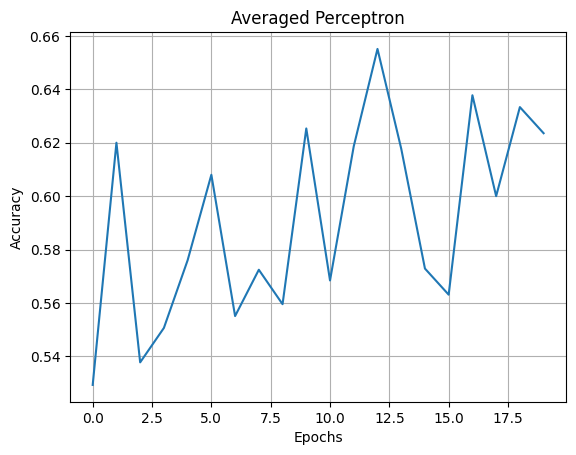

In [7]:
####### Test Average Perceptron #######

sum_classifiers = (model.a, model.ba)
best_accuracy = ph.test_accuracy_classifiers(glove_test, sum_classifiers[0], sum_classifiers[1])
        
print("\n## Averaged Perceptron ##")
print("Total number of updates performed on training set: ", model.num_updates)
print("Best accuracy on test set after 20 epochs: ", best_accuracy)
# print("Best accuracy on dev set within 20 epochs: ", best_accuracy)
w = sum_classifiers[0]
b = sum_classifiers[1]
print("Accuracy on test set: ", best_accuracy)
ph.plot_learning_curve(acc_dict, 'Averaged Perceptron')


In [8]:
a = best_a
ba = best_ba

ph.eval_guesses_to_csv(a, ba, glove_eval.drop(columns=['label']), "tfidf.eval.guesses.csv")

[ -4.4002953    4.717408    -7.981161     0.5828016    6.1565475
   0.8651427    3.9806938   13.271554    -5.7342086    3.2023234
  13.9798355    4.2064285  -10.91473     11.597671    -1.2461855
  -0.46055907   5.553576    -1.7399113    2.889698     2.1816366
   0.93701756   2.5308814    3.4025068   -7.006879    -1.0081275
  -3.7304218   -9.307318    -6.8651977    6.56583      6.6886106
   4.710702    -2.5573432    1.8465472  -10.596524    -1.9054408
  -1.1869051    0.137914     6.292101     3.3162677    3.537185
  -4.410262     0.55237186   5.816772     1.9275024   -0.508023
  -0.90081143   3.7398112  -12.272506    -1.6465484    4.965935
   3.9954455    6.8581414    2.349516    -7.290448    -0.47149992
   1.5291313   -1.4131485    1.736933     4.2440143    1.6198355
  -0.21103537  -5.912613     0.6921801   -7.7517886    5.2369537
   1.5279584  -10.347357    -8.311955    -1.540272     9.903244
   2.4050748   -1.8557676   -0.63701355  -5.1755147    2.453902
   2.2599678   -5.7797456    